In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
import glob
from os.path import join, basename
from skimage.util import img_as_ubyte
import skimage as ski
from skimage import filters
from skimage import exposure

In [4]:
# Your file paths
DATAROOT = r"E:\Documentos\01_DTU\DTU-TFM\Fotos\DOE\1\3 cropped"

# List of file paths for all images
image_files = sorted(glob.glob(join(DATAROOT, '*.jpg')))

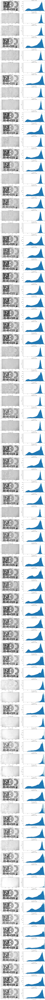

In [5]:
fig, axs = plt.subplots(len(image_files), 2, figsize=(15, 4 * len(image_files)))

# Create a CLAHE object
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))

# Calculate the histograms and contrast metric, and populate the subplots
for i in range(len(image_files)):
    img = cv2.imread(image_files[i], 0)

    # Apply CLAHE to the image
    img_clahe = clahe.apply(img)

    # Display the image
    axs[i, 0].imshow(img_clahe, cmap='gray', vmin=0, vmax=255)
    axs[i, 0].set_title(f'{basename(image_files[i])} - CLAHE')

    # Display the histogram for the CLAHE-enhanced image
    axs[i, 1].hist(img_clahe.ravel(), 256, [0, 256])
    axs[i, 1].set_title(f'Histogram {i+1} - CLAHE')
    axs[i, 1].set_xlabel('Intensity Value')
    axs[i, 1].set_ylabel('Count')
    axs[i, 1].set_xlim([0, 256])

plt.tight_layout()
plt.show()